## Análisis y Tratamiento de Imágenes Satelitales

## TP2

### 1) Dada una imagen satelital óptica separada en bandas, calcular los índices NDVI, NDWI y SAVI y mostrarlos como imágenes.

In [195]:
import cv2
import rasterio
from rasterio import plot
import numpy as np
from scipy.ndimage import convolve
import matplotlib.pyplot as plt

In [127]:
# Primero, se carga la imagen satelital óptica por bandas
imagePath = "C:/Users/arnic/Desktop/Ariel/MCD/13 - A y T de Imagenes satelitales/Images/Cordillera2/"
band2 = rasterio.open(imagePath + "LC08_L2SP_232088_20250305_20250312_02_T1_SR_B2.TIF") # Azul
band3 = rasterio.open(imagePath + "LC08_L2SP_232088_20250305_20250312_02_T1_SR_B3.TIF") # Verde
band4 = rasterio.open(imagePath + "LC08_L2SP_232088_20250305_20250312_02_T1_SR_B4.TIF") # Rojo
band5 = rasterio.open(imagePath + "LC08_L2SP_232088_20250305_20250312_02_T1_SR_B5.TIF") # Infrarrojo cercano, nir
band6 = rasterio.open(imagePath + "LC08_L2SP_232088_20250305_20250312_02_T1_SR_B6.TIF") # Infrarrojo de onda corta 1, swir1

In [128]:
# Se observa el tamaño de la imagen
band2.shape

(7741, 7711)

In [ ]:
# Se leen las bandas

red = band4.read(1).astype('float32')
green = band3.read(1).astype('float32')
blue = band2.read(1).astype('float32')
nir = band5.read(1).astype('float32')
swir1 = band6.read(1).astype('float32')

# Se aplica normalización simple (0–1)

def normalize(band):
    band_min, band_max = np.percentile(band, (2, 98))  # Recorte para mejorar contraste
    return np.clip((band - band_min) / (band_max - band_min), 0, 1)

red_norm = normalize(red)
green_norm = normalize(green)
blue_norm = normalize(blue)
nir_norm = normalize(nir)
swir1_norm = normalize(swir1)

El NDVI (Normalized Difference Vegetation Index) o Índice de Vegetación de Diferencia Normalizada es el más común de varios índices de vegetación derivados de observaciones en imágenes satelitales. El NDVI mide la cantidad y vigor de la vegetación. Se basa en el hecho de que la vegetación absorbe fuertemente la luz roja (para la fotosíntesis) y refleja fuertemente el infrarrojo cercano (NIR). Es decir,que valores bajos de luz reflejada en el color rojo, combinados con alta reflexión en el infrarrojo, indican una mayor actividad fotosintética o cantidad y densidad de plantas verdes.

In [ ]:
# Se define la función para calcular el NDVI (Normalized Difference Vegetation Index):

def calculate_ndvi(nir, red):
    """
    Calcula el Índice de Vegetación de Diferencia Normalizada (NDVI).
    NDVI = (NIR - Rojo) / (NIR + Rojo)

    Args:
        nir (np.ndarray): Array NumPy de la banda del Infrarrojo Cercano (NIR).
        red (np.ndarray): Array NumPy de la banda Roja.

    Returns:
        np.ndarray: Array NumPy con los valores del NDVI.
    """
    # Se calcula el denominador y manejo de la división por cero
    denominator = nir + red
    
    # Reemplazar los ceros en el denominador con un valor pequeño para evitar NaN/Inf
    # Esto ocurre en píxeles donde NIR+Red es 0 (e.g., nubes densas, áreas en sombra profunda, etc.)
    denominator[denominator == 0] = 1e-9 # Un valor muy pequeño

    # Finalmente se calcula el NDVI
    ndvi = (nir - red) / denominator

    return ndvi


In [132]:
# Se calcula el NDVI para la imagen satelital óptica utilizando la banda 5 (nir) y la banda 4 (rojo)
ndvi_result = calculate_ndvi(nir_norm, red_norm)

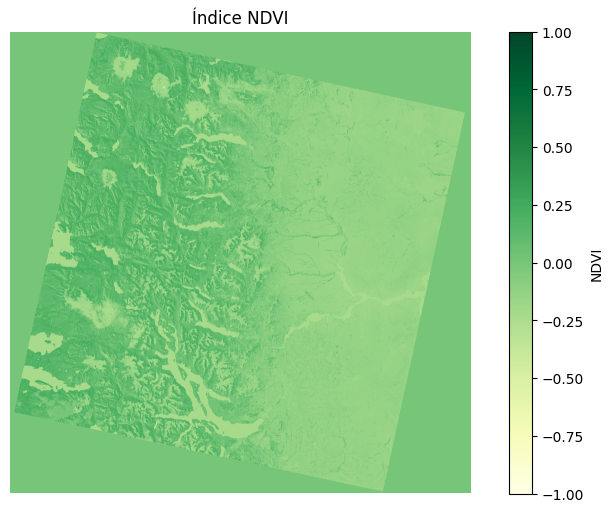

In [ ]:
# Se visualiza el resultado
plt.figure(figsize=(10, 6))
plt.imshow(ndvi_result, cmap='YlGn', vmin=-1, vmax=1) 
plt.colorbar(label='NDVI')
plt.title("Índice NDVI")
plt.axis('off')
plt.show()

In [ ]:
# Valores de NDVI cercanos a +1 indican vegetación saludable, miestras que valores cercanos a 0, indican suelo desnudo. Además, valores negativos indican agua, nubes o nieve. 
# En la imagen se observan zonas puntuales con vegetación saludable y también zonas con agua, características de la región cordillerana.

El NDWI (Normalized difference Water Index) o Índice de Agua de Diferencia Normalizada se utiliza para resaltar el aspecto de las masas de agua en una imagen de satélite. Para ello, se reduce considerablemente la reflectancia del suelo y la vegetación, lo que permite que dichas masas de agua “destaquen” en la imagen. Dado que el índice NDWI mide efectivamente el contenido de humedad, se suele comparar con el índice NDMI, también conocido como NDWI GAO. De hecho, hay una gran diferencia en la forma de calcular y utilizar ambos. El NDMI utiliza la combinación NIR-SWIR (infrarrojo cercano e infrarrojo de onda corta) para resaltar la presencia de agua en las hojas de las plantas. El NDWI, por su parte, se calcula utilizando la combinación GREEN-NIR (verde visible e infrarrojo cercano), lo que le permite detectar cambios sutiles en la cantidad de agua de las masas de agua.

In [ ]:
# Se define la función que va a determinar el NDWI (Normalized difference Water Index)

def calculate_ndwi(green, nir):
    """
    Calcula el Índice de Agua de Diferencia Normalizada (NDWI) - versión McFeeters.
    NDWI = (Verde - NIR) / (Verde + NIR)
    Útil para detectar cuerpos de agua.

    Args:
        green (np.ndarray): Array NumPy de la banda Verde.
        nir (np.ndarray): Array NumPy de la banda del Infrarrojo Cercano (NIR).

    Returns:
        np.ndarray: Array NumPy con los valores del NDWI.
    """
    denominator = green + nir
    denominator[denominator == 0] = 1e-9 # Manejar división por cero

    ndwi = (green - nir) / denominator

    return ndwi

In [110]:
# Se calcula el NDWI para la imagen satelital óptica utilizando la banda 3 (verde) y la banda 5 (nir)
ndwi_result = calculate_ndwi(green_norm, nir_norm)

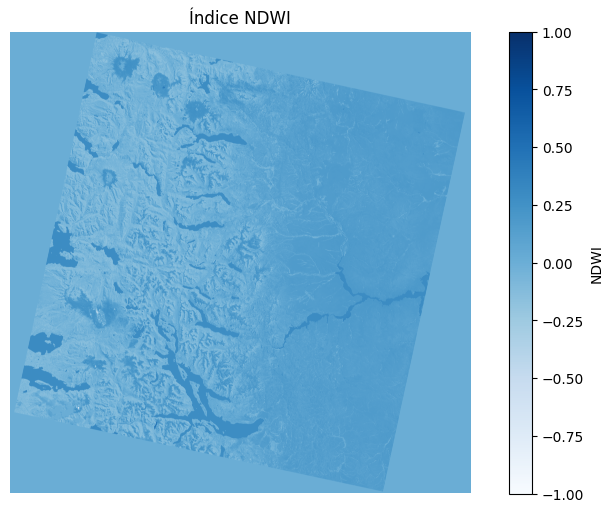

In [ ]:
# Se visualiza el resultado
plt.figure(figsize=(10, 6))
plt.imshow(ndwi_result, cmap='Blues', vmin=-1, vmax=1) 
plt.colorbar(label='NDWI')
plt.title("Índice NDWI")
plt.axis('off')
plt.show()

In [ ]:
# Valores de NDWI cercanos a +1 indican presencia de agua, mientras que valores cercanos a -1 representan suelo y vegetación.

El SAVI (Soil Adjusted Vegetation Index) o Índice de Vegetación Ajustado al Suelo fue diseñado para minimizar las influencias del brillo del suelo. Su creador, Huete, agregó un factor de ajuste del suelo L a la ecuación de NDVI para corregir los efectos del ruido del suelo (color del suelo, humedad del suelo, variabilidad del suelo a través de la región, etc.), que tienden a afectar a los resultados.

In [ ]:
# Se define la función que va a determinar el SAVI (Soil Adjusted Vegetation Index)

def calculate_savi(nir, red, L=0.5):
    """
    Calcula el Índice de Vegetación Ajustado al Suelo (SAVI).
    SAVI = ((NIR - Rojo) / (NIR + Rojo + L)) * (1 + L)
    'L' es un factor de ajuste del suelo (0.5 es un valor común).

    Args:
        nir (np.ndarray): Array NumPy de la banda del Infrarrojo Cercano (NIR).
        red (np.ndarray): Array NumPy de la banda Roja.
        L (float): Factor de ajuste del suelo.

    Returns:
        np.ndarray: Array NumPy con los valores del SAVI.
    """
    denominator = nir + red + L
    denominator[denominator == 0] = 1e-9 # Manejar división por cero

    savi = ((nir - red) / denominator) * (1 + L)

    return savi


In [122]:
# Se calcula el SAVI para la imagen satelital óptica utilizando la banda 5 (nir) y banda 4 (rojo)
savi_result = calculate_savi(nir_norm, red_norm)

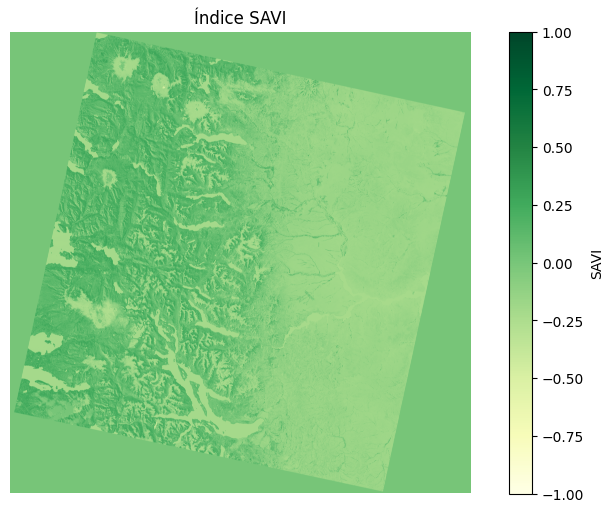

In [ ]:
# Se visualiza el resultado del SAVI
plt.figure(figsize=(10, 6))
plt.imshow(savi_result, cmap='YlGn', vmin=-1, vmax=1)
plt.colorbar(label='SAVI')
plt.title("Índice SAVI")
plt.axis('off')
plt.show()

In [ ]:
# Valores de SAVI cercanos a +1 indican alta densidad vegetal, mientras que valores cercanos o menores a 0 indican suelo desnudo o zonas urbanas.

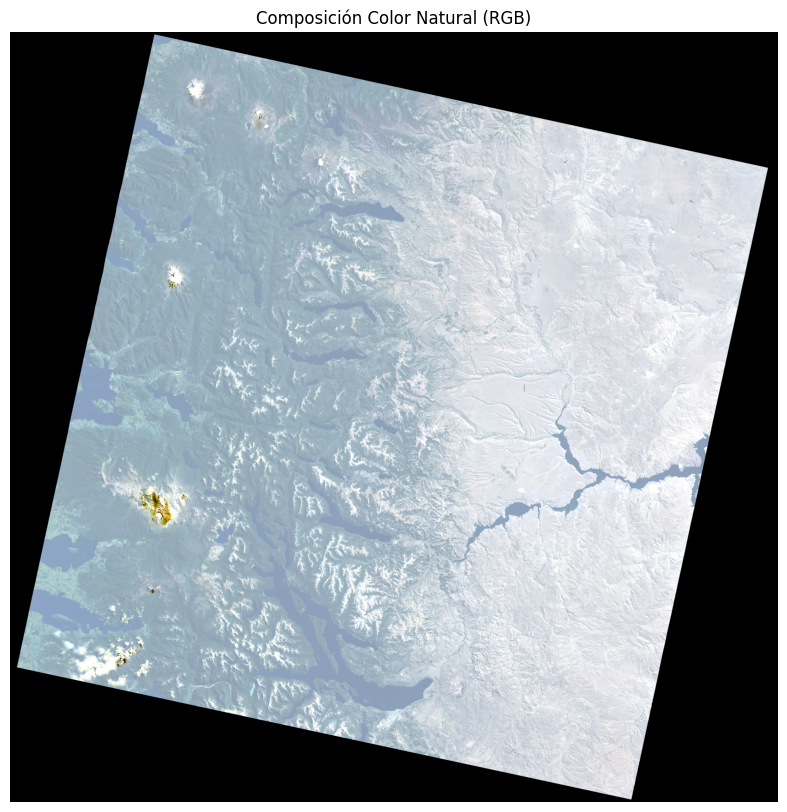

In [ ]:
# Se combina en un array RGB para poder visualizar

rgb = np.dstack((red_norm, green_norm, blue_norm))

# Se visualiza la imagen satelital
plt.figure(figsize=(10, 10))
plt.imshow(rgb)
plt.title("Composición Color Natural (RGB)")
plt.axis('off')
plt.show()

### 2) Implementar una ventana deslizante que pueda aplicarse a una imagen con mascaras de tamano variable, cuadrada y aplicar a una imagen las siguientes máscaras:

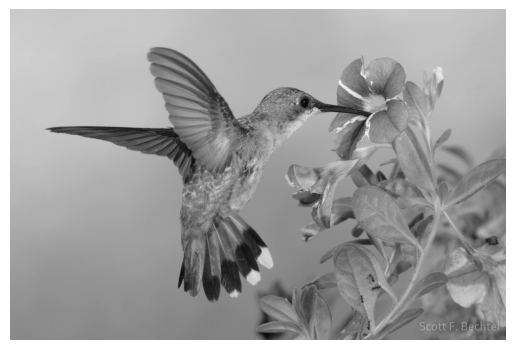

In [ ]:
# Como primer paso se selecciona una imagen y se le añade ruido.

img = cv2.imread("C:/Users/arnic/Desktop/Ariel/MCD/13 - A y T de Imagenes satelitales/Images/colibri.jpg", cv2.IMREAD_GRAYSCALE)

# Así entonces, se puede desplegar la imagen seleccionada
plt.imshow(img, cmap='gray')
plt.axis('off')  # Opcional: Oculta los ejes
plt.show()

In [ ]:
# En este caso, se pretende añadir ruido aditivo, definiendo al función que permite agregar ruido Gaussiano:

def agregar_ruido_gaussiano(imagen_rgb, porcentaje, media=0, desvio=20):
    """
    Agrega ruido Gaussiano aditivo a un porcentaje de los píxeles de la imagen.
    
    Args:
        imagen_rgb: imagen.
        porcentaje: porcentaje de píxeles a contaminar (0–100).
        media: media del ruido.
        desvio: desviación estándar del ruido.
        
    Returns:
        Imagen con ruido gaussiano agregado.
    """
    imagen = imagen_rgb.astype(np.float32)
    total_pixeles = imagen.shape[0] * imagen.shape[1]
    n_ruido = int(total_pixeles * (porcentaje / 100))
    
    indices = np.random.choice(total_pixeles, n_ruido, replace=False)
    ruido = np.random.normal(media, desvio, (n_ruido, 1))  

    flat = imagen.reshape(-1, 1)
    flat[indices] += ruido
    
    flat = 255 * (flat - flat.min()) / (flat.max() - flat.min())

    return flat.reshape(imagen.shape).astype(np.uint8)

In [590]:
# Se definen los parámetros
porcentaje_gauss = 20     # % de los píxeles
media = 0
desvio = 20

# Se aplica el ruido aditivo
imagen_gauss = agregar_ruido_gaussiano(img, porcentaje_gauss, media, desvio)

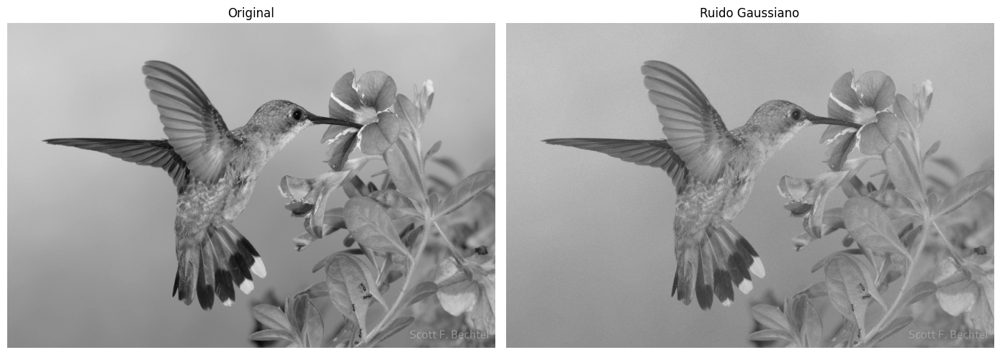

In [596]:
# Ahora se comparan los resultados con la imagen original
def mostrar(imagenes, titulos):
    plt.figure(figsize=(14, 8))
    for i, (img, title) in enumerate(zip(imagenes, titulos), 1):
        plt.subplot(1, len(imagenes), i)
        plt.imshow(img, cmap='gray')
        plt.title(title)
        plt.axis("off")
    plt.tight_layout()
    plt.show()

mostrar([img, imagen_gauss],
        ["Original", "Ruido Gaussiano"])

a) Suavizado con el filtro de la media.

In [592]:
# Se define la funcion que permite realizar el suavizado con el filtro de la media:

def suavizado_media(img, size_ventana):
    """
    Aplica un filtro de media (promedio) usando una máscara cuadrada de tamaño variable.

    Args:
        img (np.ndarray): Imagen de entrada (color o escala de grises).
        size_ventana (int): Tamaño de la máscara cuadrada (debe ser impar, e.g., 3, 5, 7...).

    Returns:
        np.ndarray: Imagen suavizada.
    """
    if size_ventana % 2 == 0:
        raise ValueError("El tamaño de la ventana debe ser impar.") # se asegura que el tamano sea impar

    return cv2.blur(img, (size_ventana, size_ventana))

In [ ]:
# Se define el tamaño de la máscara
size = 5  

In [594]:
# Se aplica el suavizado
img_media = suavizado_media(imagen_gauss, size)

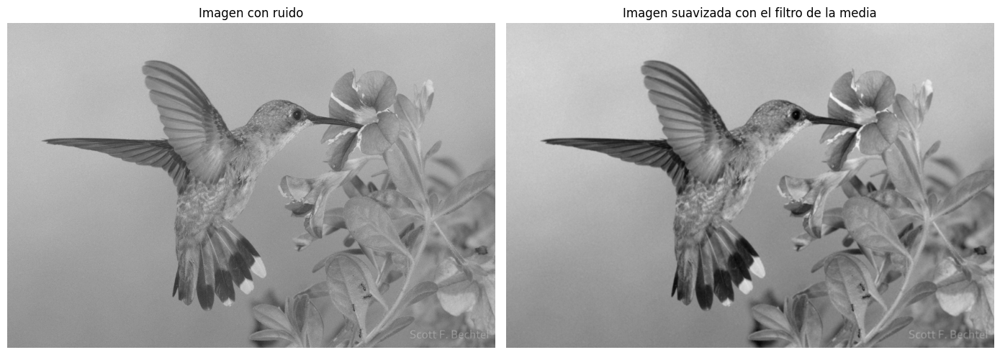

In [595]:
# Se compara la imagen original y la imagen suavizada
plt.figure(figsize=(14, 8))
plt.subplot(1, 2, 1)
plt.imshow(imagen_gauss, cmap='gray')
plt.title('Imagen con ruido')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_media, cmap='gray')
plt.title('Imagen suavizada con el filtro de la media')
plt.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# El filtro de la media es una técnica de suavizado que reemplaza cada píxel de la imagen por el promedio de los valores de los píxeles vecinos dentro de una ventana deslizante (máscara o kernel).
# En el ejemplo se observa una imagen filtrada con bordes y detalles suavizados pero con ruido presente aún.

b) Suavizado con el filtro de la mediana.

In [597]:
# Se define la funcion que permite realizar el suavizado con el filtro de la mediana:

def suavizado_mediana(img, size_ventana):
    """
    Aplica un filtro de mediana usando una máscara cuadrada de tamaño variable.

    Args:
        img (np.ndarray): Imagen de entrada (color o escala de grises).
        size_ventana (int): Tamaño de la máscara (debe ser impar).

    Returns:
        np.ndarray: Imagen suavizada con el filtro de mediana.
    """
    if size_ventana % 2 == 0:
        raise ValueError("El tamaño de la ventana debe ser impar.")

    return cv2.medianBlur(img, size_ventana)

In [ ]:
# Se define el tamaño de la máscara
size = 7  

In [599]:
# Se aplica el suavizado
img_mediana = suavizado_mediana(imagen_gauss, size)

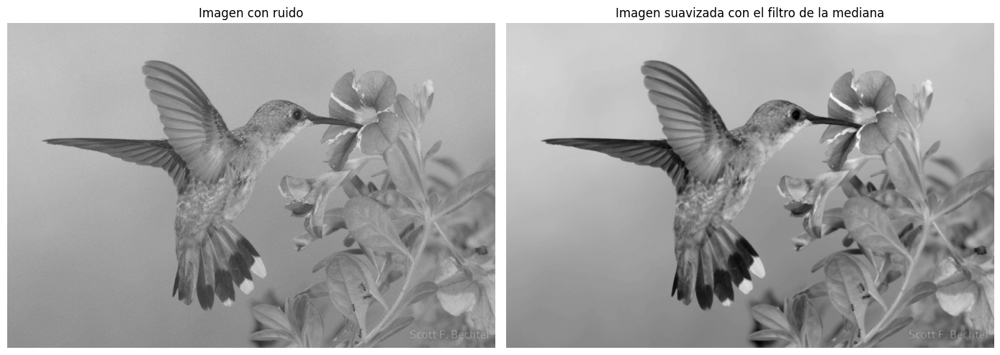

In [600]:
# Se compara la imagen original y la imagen suavizada
plt.figure(figsize=(14, 8))
plt.subplot(1, 2, 1)
plt.imshow(imagen_gauss, cmap='gray')
plt.title('Imagen con ruido')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_mediana, cmap='gray')
plt.title('Imagen suavizada con el filtro de la mediana')
plt.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
# El filtro de la mediana es un tipo de filtro es especialmente útil para eliminar ruido impulsivo (como el "sal y pimienta") sin afectar tanto los bordes como lo hace el filtro de la media.
# En esta imagen suavizada se observa reducción del ruido y conservación de bordes.

c) Suavizado con el filtro de la mediana ponderada de 3 × 3.

El filtro de la mediada ponderada es una variante del filtro de mediana donde se toma una ventana (por ejemplo 3×3) de píxeles vecinos, luego, en lugar de aplicar una mediana directa, se da más importancia (peso) a ciertos píxeles (por ejemplo, el centro de la ventana) y se selecciona como resultado el píxel más representativo según esos pesos. La implementación más común es repetir cada valor de píxel de la ventana tantas veces como su peso, y luego calcular la mediana del conjunto expandido.

In [ ]:
# Se define la funcion que permite realizar el suavizado con el filtro de la mediana ponderada de 3 x 3:

def mediana_ponderada(imagen, kernel_pesos=None):
    """
    Aplica una mediana ponderada no lineal con una ventana 3x3 sobre una imagen en escala de grises.

    Args:
        imagen: imagen en escala de grises (uint8, 2D).
        kernel_pesos: matriz 3x3 de pesos enteros positivos. Si None, se usa una gaussiana por defecto.

    Returns:
        Imagen filtrada (uint8, 2D).
    """
    if kernel_pesos is None:
        kernel_pesos = np.array([[1, 2, 1],
                                 [2, 4, 2],
                                 [1, 2, 1]], dtype=np.int32)
    else:
        kernel_pesos = np.array(kernel_pesos, dtype=np.int32)
        assert kernel_pesos.shape == (3, 3), "El kernel debe ser de tamaño 3x3"

    imagen = imagen.astype(np.uint8)
    padded = cv2.copyMakeBorder(imagen, 1, 1, 1, 1, cv2.BORDER_REFLECT)
    resultado = np.zeros_like(imagen)

    # Recorre la imagen aplicando la ventana 3x3
    for i in range(1, padded.shape[0] - 1):
        for j in range(1, padded.shape[1] - 1):
            ventana = padded[i-1:i+2, j-1:j+2]
            valores = ventana.flatten()
            pesos = kernel_pesos.flatten()
            ponderado = np.repeat(valores, pesos)
            resultado[i-1, j-1] = np.median(ponderado)

    return resultado


In [602]:
# Se aplica el filtro a la imagen con ruido

imagen_mpond = mediana_ponderada(imagen_gauss)

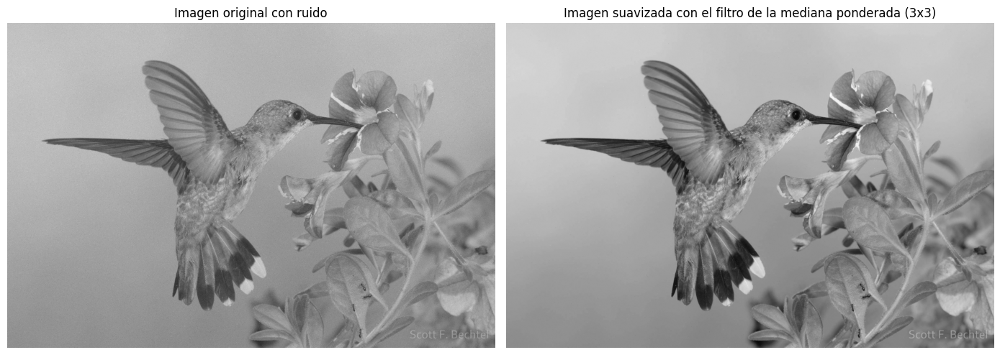

In [603]:
# Se comparan los resultados obtenidos

plt.figure(figsize=(14, 8))
plt.subplot(1, 2, 1)
plt.imshow(imagen_gauss, cmap='gray')
plt.title("Imagen original con ruido")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(imagen_mpond, cmap='gray')
plt.title("Imagen suavizada con el filtro de la mediana ponderada (3x3)")
plt.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
# Se observa que la imagen donde se aplicó el filtro de la mediana ponderada preserva mejor los bordes y detalles. Esto se debe a que el filtro ponderado da más peso al 
# píxel central y a sus vecinos inmediatos, haciendo que el resultado tienda a mantener el valor original si hay uniformidad. La ponderada favorece los valores predominantes
# cerca del centro, respetando mejor las texturas suaves. 

d) Suavizado con el filtro de Gauss para diferentes valores de $\sigma$ y $\mu = 0$.

In [607]:
# Se lista de valores de sigma a probar

sigmas = [10, 30, 50, 100, 500]

In [608]:
# Se aplicar el filtro Gaussiano con kernel 3x3 y diferentes sigmas:

imagenes_filtradas = []
for sigma in sigmas:
    img_blur = cv2.GaussianBlur(imagen_gauss, (3, 3), sigmaX=sigma, sigmaY=sigma)
    imagenes_filtradas.append(img_blur)

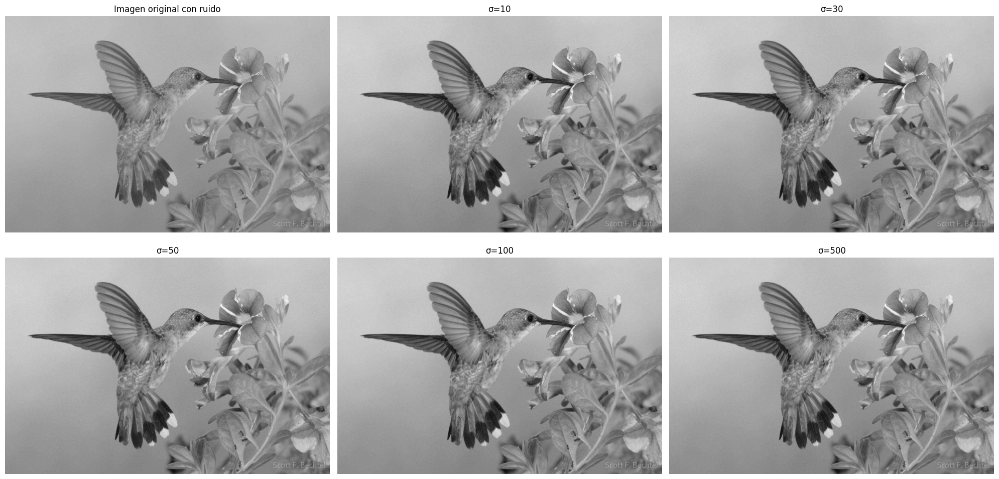

In [609]:
# Se visualizan y comparan los resultados

plt.figure(figsize=(20, 10))
plt.subplot(2, 3, 1)
plt.imshow(imagen_gauss, cmap='gray')
plt.title('Imagen original con ruido')
plt.axis('off')

for i, (img, sigma) in enumerate(zip(imagenes_filtradas, sigmas)):
    plt.subplot(2, 3, i + 2)
    plt.imshow(img, cmap='gray')
    plt.title(f'σ={sigma}')
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# En las imágenes se observa que a mayor sigma, mayor desenfoque (el filtro se vuelve más amplio aunque el kernel siga siendo 3×3).

e) Realce de Bordes.

El realce de bordes es un tipo de filtro que destaca las transiciones abruptas en la intensidad, es decir, los bordes. Un kernel comúnmente usado para realce de bordes es:
$$
Kernel de realce de bordes = \begin{bmatrix} -1 & -1 & -1 \\ -1 & 8 & -1 \\ -1 & -1 & -1 \end{bmatrix}
$$

Este kernel realza los cambios intensos entre un píxel y sus vecinos.



In [ ]:
# Se define la función que permita aplicar el filtro de realce de bordes:

def realce_bordes(imagen):
    """
    Aplica una máscara de realce de bordes (3x3) a una imagen en escala de grises.

    Args:
        imagen: imagen en escala de grises (uint8).

    Returns:
        Imagen con bordes realzados (uint8).
    """
    # Máscara Laplaciana 3x3 para realce de bordes
    kernel = np.array([[-1, -1, -1],
                       [-1,  8, -1],
                       [-1, -1, -1]], dtype=np.float32)

    # Se convierte a float para evitar saturación
    imagen = imagen.astype(np.float32)

    # Se aplica convolución
    filtrada = convolve(imagen, kernel, mode='reflect')

    # Se reescalar valores al rango [0, 255]
    flat = 255 * (filtrada - filtrada.min()) / (filtrada.max() - filtrada.min())

    return flat

In [621]:
# Se aplicar el filtro de realce de bordes
imagen_bordes = realce_bordes(img)

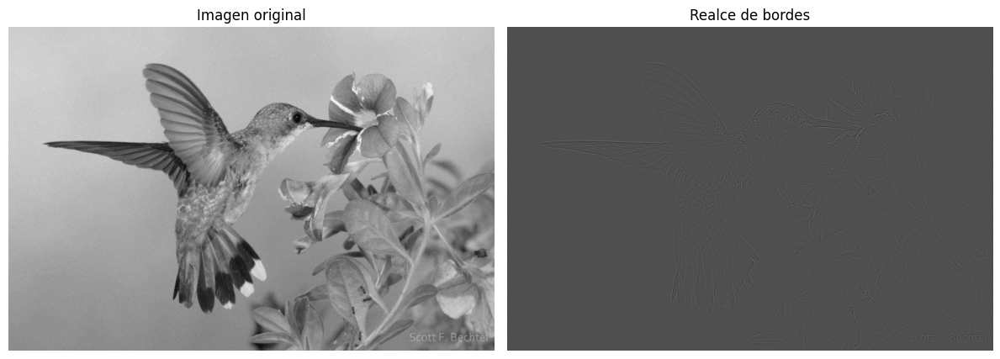

In [622]:
# Se visualizan los resultados
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(img, cmap='gray')
plt.title("Imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imagen_bordes, cmap='gray')
plt.title("Realce de bordes")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# Se observa como el realce de bordes es mas efectivos en zonas mas oscuras.

### 3) Implementar el detector de bordes por el método del gradiente utilizando los siguientes operadores de gradiente:

a) Prewitt.

El operador de Prewitt utiliza dos máscaras de convolución 3×3 para estimar el gradiente en la dirección horizontal (Gx) y vertical (Gy):
$$
Prewitt_x = \begin{bmatrix} -1 & 0 & 1 \\ -1 & 0 & 1 \\ -1 & 0 & 1 \end{bmatrix} ,
$$

$$
Prewitt_y = \begin{bmatrix} -1 & -1 & -1\\ 0 & 0 & 0 \\ 1 & 1 & 1  \end{bmatrix}
$$

Luego, se calcula la magnitud del gradiente en cada píxel como:
$$
Gradiente = \sqrt{{G^2}_x + {G^2}_y}
$$ 

In [ ]:
# Se define la función que permita detectar los bordes con Prewitt:

def prewitt_bordes(imagen):
    """
    Aplica el operador de Prewitt para detectar bordes en una imagen en escala de grises.

    Args:
        imagen_gris: imagen en escala de grises (uint8).

    Returns:
        Imagen de bordes detectados (uint8).
    """
    # Máscaras de Prewitt
    prewitt_x = np.array([[-1, 0, 1],
                          [-1, 0, 1],
                          [-1, 0, 1]], dtype=np.float32)

    prewitt_y = np.array([[-1, -1, -1],
                          [ 0,  0,  0],
                          [ 1,  1,  1]], dtype=np.float32)

    # Convertir imagen a float
    imagen = imagen.astype(np.float32)

    # Se aplica convolución con máscaras
    gx = convolve(imagen, prewitt_x, mode='reflect')
    gy = convolve(imagen, prewitt_y, mode='reflect')

    # Se calcula la magnitud del gradiente
    gradiente = np.sqrt(gx**2 + gy**2)

    # Se reescalar al rango [0, 255]
    grad = 255 * (gradiente - gradiente.min()) / (gradiente.max() - gradiente.min())

    return grad

In [653]:
# Se aplica el detector de bordes Prewitt
bordes_prewitt = prewitt_bordes(img)

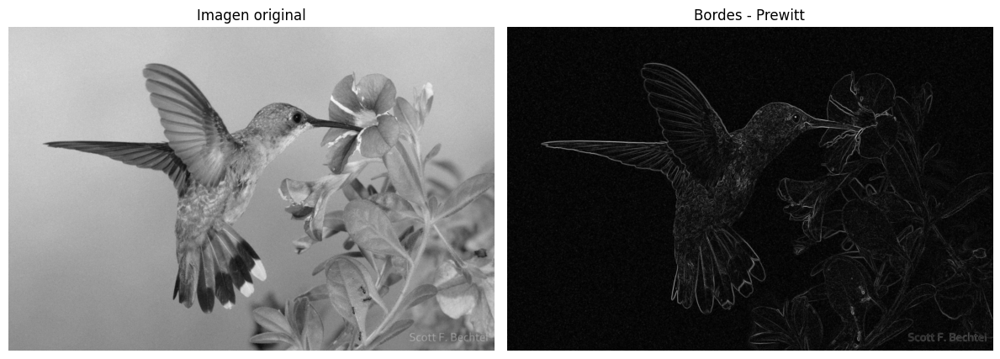

In [654]:
# Se observan los resultados
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(img, cmap='gray')
plt.title("Imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(bordes_prewitt, cmap='gray')
plt.title("Bordes - Prewitt")
plt.axis("off")

plt.tight_layout()
plt.show()

b). Sobel.

El operador de Sobel también estima el gradiente en direcciones x y y, pero da mayor peso al centro de la máscara, lo que lo hace más robusto al ruido que el de Prewitt.

Máscaras Sobel 3×3:
$$
Sobel_x = \begin{bmatrix} -1 & 0 & 1 \\ -2 & 0 & 2 \\ -1 & 0 & 1 \end{bmatrix} ,
$$

$$
Sobel_y = \begin{bmatrix} -1 & -2 & -1 \\ 0 & 0 & 0 \\ 1 & 2 & 1 \end{bmatrix}
$$

In [ ]:
# Se define la función que permita detectar los bordes con Sobel:

def sobel_bordes(imagen):
    """
    Aplica el operador de Sobel para detectar bordes en una imagen en escala de grises.

    Args:
        imagen_gris: imagen en escala de grises (uint8).

    Returns:
        Imagen con bordes resaltados por Sobel (uint8).
    """
    # Máscaras de Sobel
    sobel_x = np.array([[-1, 0, 1],
                        [-2, 0, 2],
                        [-1, 0, 1]], dtype=np.float32)

    sobel_y = np.array([[-1, -2, -1],
                        [ 0,  0,  0],
                        [ 1,  2,  1]], dtype=np.float32)

    # Se convierte a float para evitar desbordes
    imagen = imagen.astype(np.float32)

    # Se calculan los gradientes en X e Y
    gx = convolve(imagen, sobel_x, mode='reflect')
    gy = convolve(imagen, sobel_y, mode='reflect')

    # Se calcula la magnitud del gradiente
    gradiente = np.sqrt(gx**2 + gy**2)

    # Se reescalar al rango [0, 255]
    grad = 255 * (gradiente - gradiente.min()) / (gradiente.max() - gradiente.min())

    return grad

In [656]:
# Se Detectan los bordes con Sobel

bordes_sobel = sobel_bordes(img)

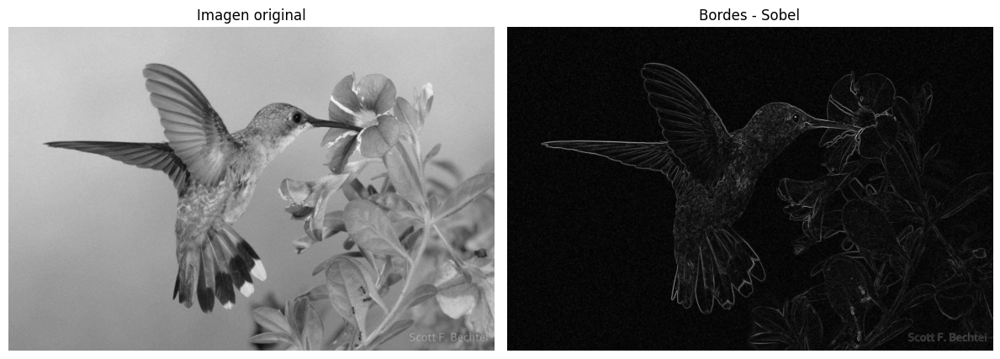

In [ ]:
# Se visualizan los resultados
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(img, cmap='gray')
plt.title("Imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(bordes_sobel, cmap='gray')
plt.title("Bordes - Sobel")
plt.axis("off")

plt.tight_layout()
plt.show()

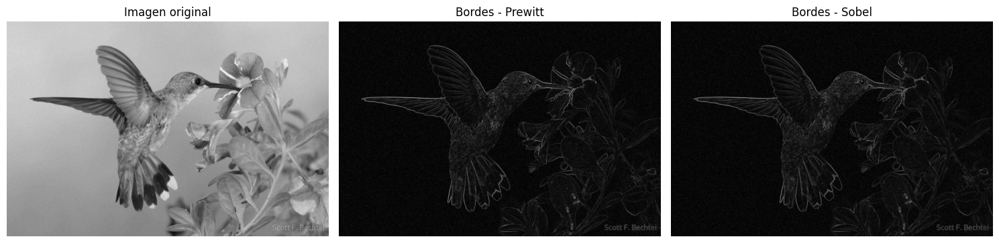

In [659]:
# Se comparan los operadores
plt.figure(figsize=(15, 8))
plt.subplot(1, 3, 1)
plt.imshow(img, cmap='gray')
plt.title("Imagen original")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.imshow(bordes_prewitt, cmap='gray')
plt.title("Bordes - Prewitt")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.imshow(bordes_sobel, cmap='gray')
plt.title("Bordes - Sobel")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# Al comparar los resultados, se observa que el operador Sobel permite detectar los bordes de manera mas definida.

### 4) Implementar los siguientes detectores de borde y aplicarlos a dos imágenes y a sus versiones contaminadas:

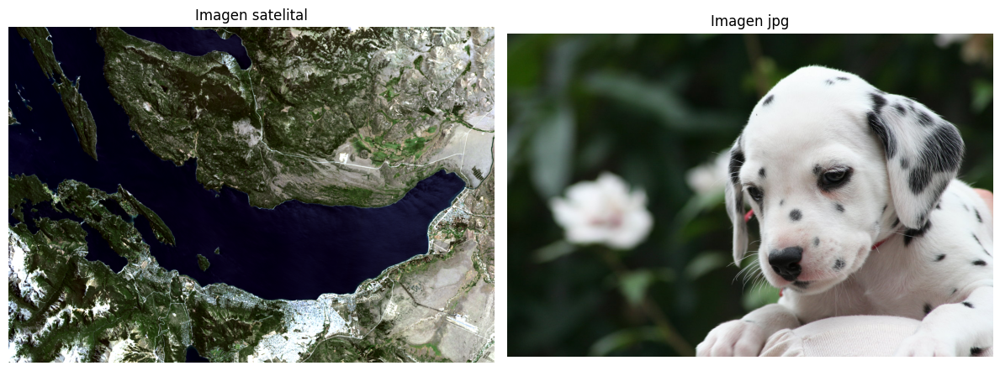

In [668]:
# Se seleccioanan las imágenes:

img1 = cv2.imread("C:/Users/arnic/Desktop/Ariel/MCD/13 - A y T de Imagenes satelitales/Images/bariloche2/bgr.tif")
imgsat_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)

img2 = cv2.imread("C:/Users/arnic/Desktop/Ariel/MCD/13 - A y T de Imagenes satelitales/Images/dog2.jpg")
imgdog_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_rgb)
plt.title("Imagen satelital")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_rgb)
plt.title("Imagen jpg")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# Se define la función que permite agregar el ruido Sal y Pimienta

def agregar_ruido_sal_pimienta(imagen_rgb, porcentaje):
    """
    Aplica ruido Sal y Pimienta a un porcentaje de píxeles de una imagen BGR.

    Args:
        imagen_bgr: imagen de entrada (color).
        porcentaje: porcentaje de píxeles a contaminar (0–100).

    Returns:
        Imagen con ruido sal y pimienta.
    """
    imagen = imagen_rgb.copy()
    total_pixeles = imagen.shape[0] * imagen.shape[1]
    num_ruido = int(total_pixeles * porcentaje / 100)

    # Coordenadas aleatorias para sal y pimienta
    coords = np.random.choice(total_pixeles, size=num_ruido, replace=False)
    coords = np.unravel_index(coords, (imagen.shape[0], imagen.shape[1]))

    # Se separan en mitad para sal y mitad para pimienta
    mitad = num_ruido // 2
    sal_coords = (coords[0][:mitad], coords[1][:mitad])
    pimienta_coords = (coords[0][mitad:], coords[1][mitad:])

    # Se plica el ruido
    imagen[sal_coords] = [255, 255, 255]       # Sal (blanco)
    imagen[pimienta_coords] = [0, 0, 0]        # Pimienta (negro)

    return imagen

In [636]:
# Se aplica el ruido sal y pimienta
imgsat_sp = agregar_ruido_sal_pimienta(imgsat_rgb, porcentaje=8)  # % de los píxeles

imgdog_sp = agregar_ruido_sal_pimienta(imgdog_rgb, porcentaje=8)  # % de los píxeles

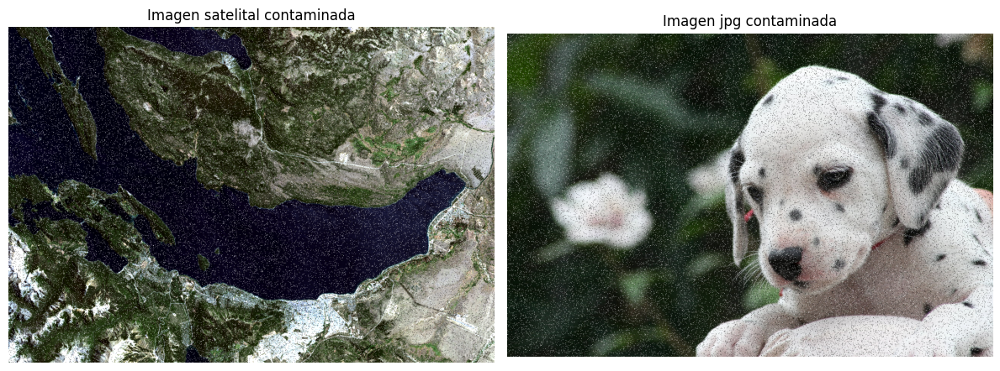

In [ ]:
# Se visualizan los resultados
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_sp)
plt.title("Imagen satelital contaminada")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_sp)
plt.title("Imagen jpg contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

a) Método del Laplaciano.

El Laplaciano es un operador de segundo orden que mide la curvatura o los cambios de intensidad en una imagen. Se basa en la suma de derivadas parciales de segundo orden, y puede resaltar bordes en todas direcciones (horizontal, vertical y diagonal).

Máscara Laplaciana común (3×3):
$$
Laplaciano = \begin{bmatrix} 0 & -1 & 0 \\ -1 & 4 & -1 \\ 0 & -1 & 0 \end{bmatrix} 
$$
ó también,
$$
Laplaciano = \begin{bmatrix} -1 & -1 & -1 \\ -1 & 8 & -1 \\ -1 & -1 & -1 \end{bmatrix}
$$

In [ ]:
# Se define la función que permite aplicar el operador Laplaciano:

def laplaciano_bordes(imagen_rgb):
    """
    Aplica el operador Laplaciano para detectar bordes en una imagen RGB.

    Args:
        imagen_rgb: imagen en formato RGB (uint8).
        
    Returns:
        Imagen con bordes resaltados (uint8).
    """
    # --- Es conveniente convertir la imagen a escala de grises---
    # El operador Laplaciano (y la mayoría de los detectores de bordes) funciona mejor en imágenes en escala de grises.
     
    imagen_gris = cv2.cvtColor(imagen_rgb, cv2.COLOR_RGB2GRAY)
    
    # --- Aplicar el operador Laplaciano mediante el método cv2.Laplacian(src, ddepth, ksize, scale, delta, borderType):
    # - src: Imagen de entrada (en escala de grises).
    # - ddepth: Profundidad de bits de la imagen de salida. cv2.CV_64F es común
    #   para evitar desbordamientos, ya que el Laplaciano puede producir valores negativos.
    # - ksize: Tamaño del kernel del filtro. Debe ser impar (1, 3, 5, etc.).
    #   Un valor de 3 es el más común.
    # - scale: Factor de escala opcional para los valores calculados. Por defecto es 1.
    # - delta: Valor opcional a sumar a los resultados antes de almacenarlos. Por defecto es 0.
    # - borderType: Método de interpolación de bordes.
        
    # --- Aplicamos Laplaciano con ddepth=cv2.CV_64F para evitar pérdida de información
    # debido a valores negativos o fuera de rango [0, 255]
    laplaciano = cv2.Laplacian(imagen_gris, cv2.CV_64F, ksize=3)
    
    # --- Se convierten los resultados a un formato visualizable 
    # El Laplaciano produce valores positivos y negativos. Los valores absolutos
    # suelen representar la fuerza del cambio (borde).
    # Normalizamos los valores al rango [0, 255].
    Laplacian = cv2.convertScaleAbs(laplaciano)
        
    return Laplacian

In [680]:
# Se aplica el detector de bordes Laplaciano a ambas imágenes seleccionadas y sus verisones contaminadas

# Primero con la imagen satelital:
imgsat_laplac_rgb = laplaciano_bordes(imgsat_rgb)
imgsat_laplac_sp = laplaciano_bordes(imgsat_sp)

# Luego con la imagen jpg:
imgdog_laplac_rgb = laplaciano_bordes(imgdog_rgb)
imgdog_laplac_sp = laplaciano_bordes(imgdog_sp)


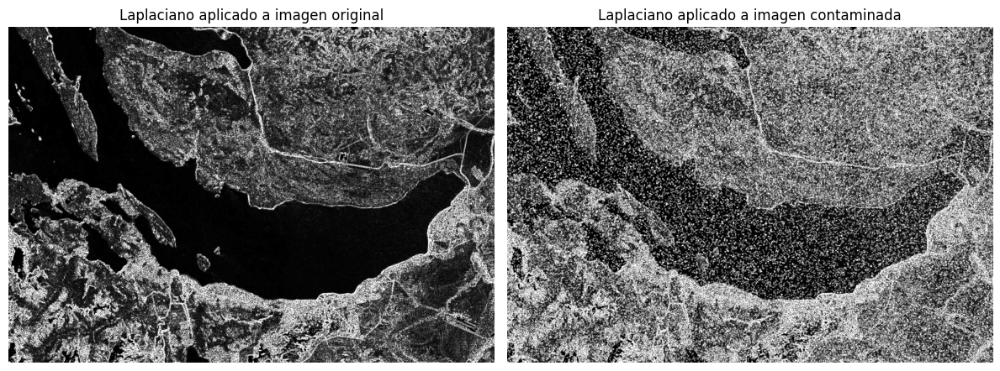

In [683]:
# Se comparan los resultados con la imagen satelital
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_laplac_rgb, cmap='gray')
plt.title("Laplaciano aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgsat_laplac_sp, cmap='gray')
plt.title("Laplaciano aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

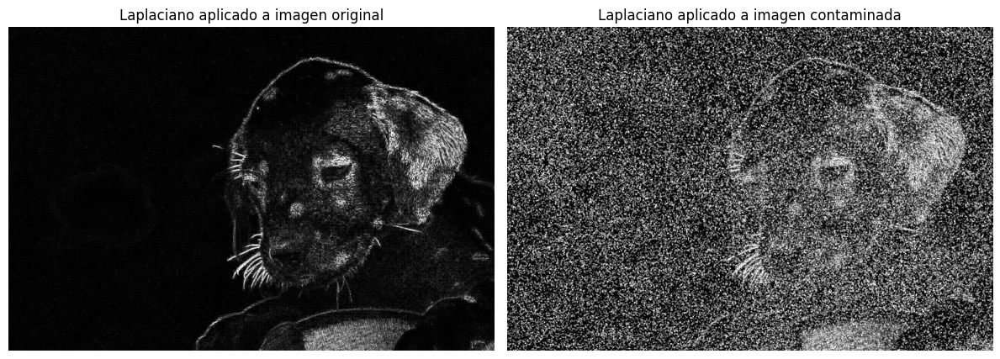

In [682]:
# Se comparan los resultados con la imagen jpg
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgdog_laplac_rgb, cmap='gray')
plt.title("Laplaciano aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_laplac_sp, cmap='gray')
plt.title("Laplaciano aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

In [368]:
# El operador Laplaciano es un detector de bordes de segunda derivada. A diferencia de los detectores de primera derivada (como Sobel o Prewitt),
# que detectan donde la intensidad de la imagen cambia (picos), el Laplaciano detecta donde la tasa de cambio de intensidad es máxima
# (cruces por cero en la segunda derivada). Esto significa que el Laplaciano tiende a resaltar los bordes como líneas delgadas y claras. Su principal desventaja,
# como se observan en las imágenes seleccionadas, es muy sensible al ruido.

b) Método del Laplaciano agregándole evaluación de la pendiente.

La idea es complementar el Laplaciano con información del gradiente (como en Sobel o Prewitt). Esto permite detectar bordes donde hay cambios de curvatura (Laplaciano), y además, tener en cuenta cuán pronunciada es la pendiente (gradiente) en esa región. Es decir, la magnitud del gradiente nos indica la fuerza de un borde, mientras que el Laplaciano nos da una idea de dónde están los cambios. 

Una forma común de hacer esto es utilizando los operadores Sobel para calcular los gradientes en las direcciones X e Y, y luego combinarlos para obtener la magnitud. Después, fusionar esta información con el Laplaciano.

In [ ]:
# Se define la función que permita aplicar el Laplaciano y evaluar la pendiente con Sobel:

def detectar_bordes_laplacian_y_gradiente(imagen_rgb, umbral_grad=20):
    """
    Detecta bordes en una imagen a color combinando el operador Laplaciano
    con la magnitud del gradiente (calculada con Sobel).

    Args:
        imagen_rgb (str): imagen de entrada (uint8).
        umbral_grad: Umbral mínimo del gradiente para considerar un borde significativo.
        
    Returns:
        Imagen resultante con bordes detectados (uint8).
    """
    # Se convierte la imagen a escala de grises
    imagen_gris = cv2.cvtColor(imagen_rgb, cv2.COLOR_RGB2GRAY)

    # --- Detección de Bordes con Laplaciano ---
    # Se aplica el operador Laplaciano
    laplaciano = cv2.Laplacian(imagen_gris, cv2.CV_64F, ksize=3)
    
    # --- Detección de Bordes con Gradiente (Sobel) ---
    # Se calculan los gradientes en X e Y
    # ddepth = cv2.CV_64F para evitar desbordamientos y manejar valores negativos
    sobelx = cv2.Sobel(imagen_gris, cv2.CV_64F, 1, 0, ksize=3) # Gradiente en dirección X
    sobely = cv2.Sobel(imagen_gris, cv2.CV_64F, 0, 1, ksize=3) # Gradiente en dirección Y

    # Se calcula la magnitud del gradiente
    magnitud_gradiente = np.sqrt(sobelx**2 + sobely**2)
    
    # Combinación: mantener Laplaciano solo donde el gradiente es fuerte
    lap_filt = np.where(magnitud_gradiente >= umbral_grad, laplaciano, 0)

    # Se normaliza la magnitud del gradiente para visualización (0-255)
    resultado = cv2.convertScaleAbs(lap_filt)
    
    return resultado


In [685]:
# Se aplica el Laplaciano + evaluación de la pendiente a ambas imágenes seleccionadas y sus verisones contaminadas

# Primero con la imagen satelital:
imgsat_ls_rgb = detectar_bordes_laplacian_y_gradiente(imgsat_rgb)
imgsat_ls_sp = detectar_bordes_laplacian_y_gradiente(imgsat_sp, umbral_grad=10)

# Luego con la imagen jpg:
imgdog_ls_rgb = detectar_bordes_laplacian_y_gradiente(imgdog_rgb)
imgdog_ls_sp = detectar_bordes_laplacian_y_gradiente(imgdog_sp, umbral_grad=10)


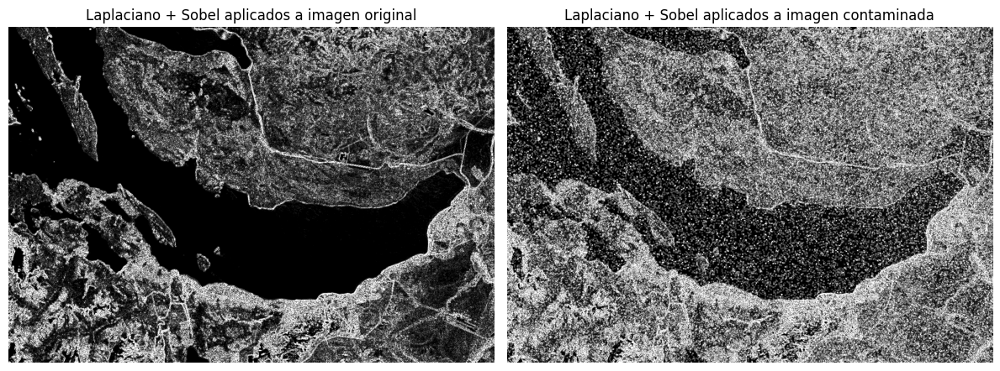

In [686]:
# Se comparan los resultados con la imagen satelital
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_ls_rgb, cmap='gray')
plt.title("Laplaciano + Sobel aplicados a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgsat_ls_sp, cmap='gray')
plt.title("Laplaciano + Sobel aplicados a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

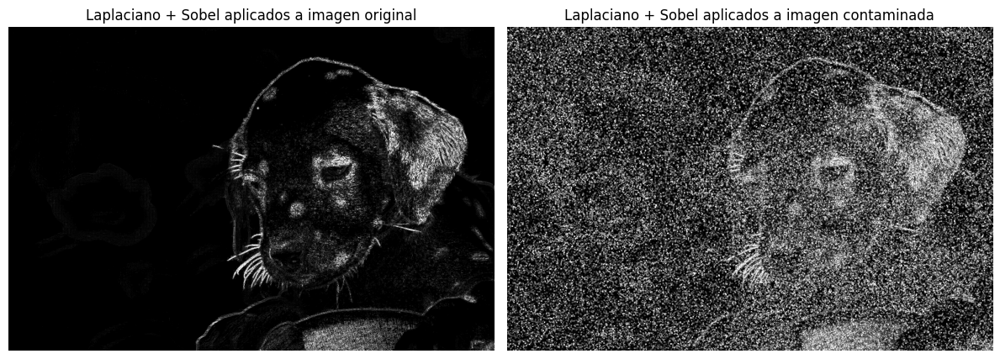

In [687]:
# Se comparan los resultados con la imagen jpg
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgdog_ls_rgb, cmap='gray')
plt.title("Laplaciano + Sobel aplicados a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_ls_sp, cmap='gray')
plt.title("Laplaciano + Sobel aplicados a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En las imágenes seleccionadas se observa cómo al combinar de estos métodos, se obtienen mejores resultados.
# El Laplaciano es excelente para detectar los "puntos" exactos donde ocurre un cambio de intensidad (los bordes finos) y la magnitud del gradiente (Sobel) da una indicación 
# de la "fuerza" o la pendiente de ese cambio, lo que ayuda a distinguir bordes fuertes de cambios sutiles o ruido al variar el valor umbral.

c). Método del Laplaciano del Gausiano (Marr-Hildreth).

El Laplaciano del Gaussiano (LoG), también conocido como operador de Marr-Hildreth, es un método popular para la detección de bordes que busca superar la sensibilidad al ruido del Laplaciano puro. Lo logra combinando un filtro Gaussiano (para suavizar la imagen y reducir el ruido) con el operador Laplaciano (para detectar los cambios de intensidad).

El LoG funciona detectando los cruces por cero en la segunda derivada de la imagen después de haber sido suavizada. Los cruces por cero corresponden a los puntos donde la intensidad de la imagen cambia más rápidamente, lo que indica la presencia de un borde.

In [ ]:
# Se define la función que permite aplicar el método LoG:

def detectar_cruce_por_cero(laplaciano):
    """
    Detecta cruces por cero en una imagen Laplaciana (2da derivada).
    Retorna una imagen binaria con 255 donde hay un cruce por cero.
    """
    cruzes = np.zeros_like(laplaciano, dtype=np.uint8)
    filas, columnas = laplaciano.shape

    for i in range(1, filas - 1):
        for j in range(1, columnas - 1):
            centro = laplaciano[i, j]

            # Se compara con los 8 vecinos
            vecinos = laplaciano[i-1:i+2, j-1:j+2].flatten()
            vecinos = np.delete(vecinos, 4)  # quitar el valor central

            # Si hay cambio de signo, hay cruce por cero
            if np.any((centro * vecinos) < 0):
                cruzes[i, j] = 255

    return cruzes

def marr_hildreth_zero_crossing(imagen_rgb, sigma=1.0, kernel_size=5):
    """
    Aplica el detector Marr-Hildreth (LoG) con detección explícita de cruces por cero.

    Args:
        imagen_rgb: Imagen RGB (uint8).
        sigma: Desviación estándar del filtro Gaussiano.
        kernel_size: Tamaño del kernel Gaussiano.

    Returns:
        Imagen binaria con los bordes detectados (uint8).
    """
    # Se convierte la imagen a escala de grises
    imagen_gris = cv2.cvtColor(imagen_rgb, cv2.COLOR_RGB2GRAY)
    
    # Se aplica el suavizado gaussiano
    suavizado = cv2.GaussianBlur(imagen_gris, (kernel_size, kernel_size), sigma)
    
    # Se aplica el Laplaciano sobre imagen suavizada
    lap = cv2.Laplacian(suavizado, ddepth=cv2.CV_32F, ksize=5)
    
    # Se detecta los cruces por cero
    bordes = detectar_cruce_por_cero(lap)
    
    return bordes


In [695]:
# Se aplica el LoG a ambas imágenes seleccionadas y sus verisones contaminadas

# Primero con la imagen satelital:
imgsat_log_rgb = marr_hildreth_zero_crossing(imgsat_rgb, sigma=5.0, kernel_size=5)
imgsat_log_sp = marr_hildreth_zero_crossing(imgsat_sp, sigma=5.0, kernel_size=5)

In [696]:
# Luego con la imagen jpg:
imgdog_log_rgb = marr_hildreth_zero_crossing(imgdog_rgb, sigma=1.0, kernel_size=5)
imgdog_log_sp = marr_hildreth_zero_crossing(imgdog_sp, sigma=5.0, kernel_size=5)

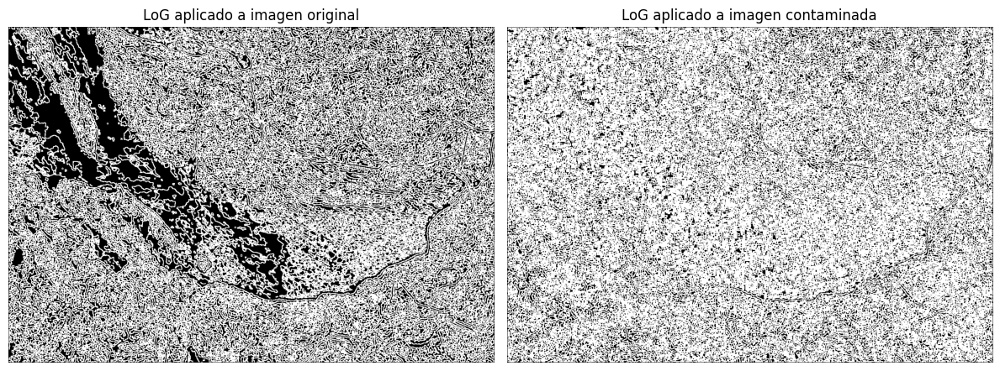

In [697]:
# Se comparan los resultados con la imagen satelital
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_log_rgb, cmap='gray')
plt.title("LoG aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgsat_log_sp, cmap='gray')
plt.title("LoG aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

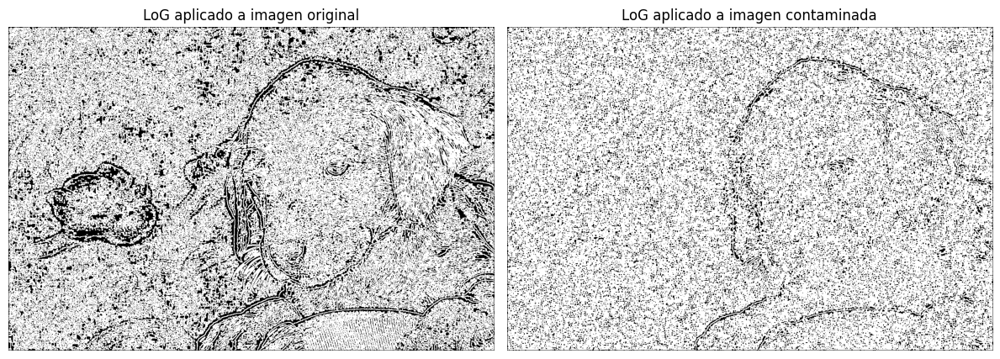

In [698]:
# Se comparan los resultados con la imagen jpg
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgdog_log_rgb, cmap='gray')
plt.title("LoG aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_log_sp, cmap='gray')
plt.title("LoG aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En las imágenes resultantes se observa que la aplicación del LoG permite detectar los bordes pero puede dar como resultado contornos gruesos o duplicados.
# Además se observa su alta sensibilidad al ruido aunque se suavize la imagen con un filtro Gaussiano. Tiene la desventaja de demandar un alto costo computacional.

### 5). Implementar el filtro bilateral y aplicarlo a imágenes y sus versiones contaminadas. Analizar los resultados y comparar con el filtro de Gauss y con el filtro de la mediana.

El filtro bilateral es una técnica utilizada para suavizar una imagen sin perder bordes. 

In [ ]:
# Se define la función que permita aplicar el filtro bilateral:

def aplicar_filtro_bilateral(imagen_rgb, d=9, sigma_color=75, sigma_espacio=75):
    """
    Aplica el filtro bilateral a una imagen RGB.

    Args:
        imagen_rgb: Imagen en formato RGB (uint8).
        d: Diámetro del área de píxeles.
        sigma_color: Desviación estándar en el espacio del color (similaridad).
        sigma_espacio: Desviación estándar en el espacio (distancia espacial).

    Returns:
        Imagen suavizada con preservación de bordes (uint8).
    """
    # Se aplica el filtro bilateral
    imagen_filtrada = cv2.bilateralFilter(imagen_rgb, d, sigma_color, sigma_espacio)

    return imagen_filtrada

In [ ]:
# Se aplica el filtro bilateral a ambas imágenes

# Primero con la imagen satelital:
imgsat_bi_rgb = aplicar_filtro_bilateral(imgsat_rgb, d=9, sigma_color=75, sigma_espacio=75)
imgsat_bi_sp = aplicar_filtro_bilateral(imgsat_sp, d=15, sigma_color=370, sigma_espacio=75)

In [719]:
# Luego con la imagen jpg:
imgdog_bi_rgb = aplicar_filtro_bilateral(imgdog_rgb, d=9, sigma_color=75, sigma_espacio=75)
imgdog_bi_sp = aplicar_filtro_bilateral(imgdog_sp, d=15, sigma_color=370, sigma_espacio=100)

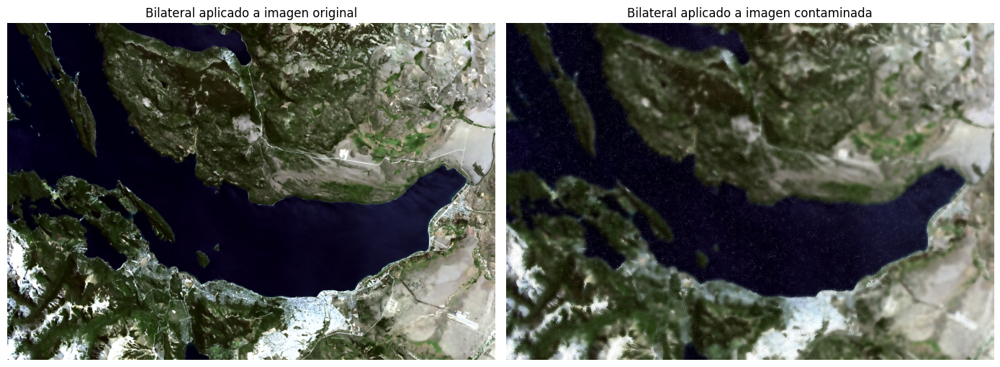

In [ ]:
# Se muestran los resultados en la imagen sateiltal
plt.figure(figsize=(14, 7))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_bi_rgb, cmap='gray')
plt.title("Bilateral aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgsat_bi_sp, cmap='gray')
plt.title("Bilateral aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

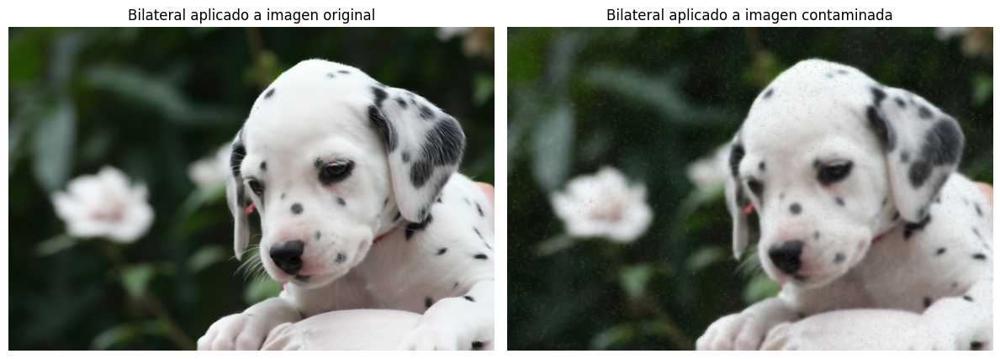

In [ ]:
# Se muestran los resultados en la imagen jpg
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgdog_bi_rgb, cmap='gray')
plt.title("Bilateral aplicado a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_bi_sp, cmap='gray')
plt.title("Bilateral aplicado a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En los resultados se observa que el filtro bilateral suaviza las imágenes sin difuminar los bordes.
# El parámetro sigma_color controla cuánto afecta la diferencia de intensidad (color). Mayor valor → más suavizado.
# El parámetro sigma_espacio controla cuánto afecta la distancia espacial. Mayor valor → considera píxeles más lejanos.

In [722]:
# Se realiza la comparación con el filtro de Gauss y el filtro de la mediana:

# Funciones de suavizado
def filtro_gaussiano(imagen_rgb, ksize=9, sigma=2):
    return cv2.GaussianBlur(imagen_rgb, (ksize, ksize), sigma)

def filtro_mediana(imagen_rgb, ksize=5):
    return cv2.medianBlur(imagen_rgb, ksize)

def filtro_bilateral(imagen_rgb, d=15, sigma_color=300, sigma_espacio=300):
    imagen_bgr = cv2.cvtColor(imagen_rgb, cv2.COLOR_RGB2BGR)
    filtrada_bgr = cv2.bilateralFilter(imagen_bgr, d, sigma_color, sigma_espacio)
    return cv2.cvtColor(filtrada_bgr, cv2.COLOR_BGR2RGB)

In [723]:
# Se aplican los filtros
imagen_gauss = filtro_gaussiano(imgdog_sp)
imagen_mediana = filtro_mediana(imgdog_sp)
imagen_bilateral = filtro_bilateral(imgdog_sp)

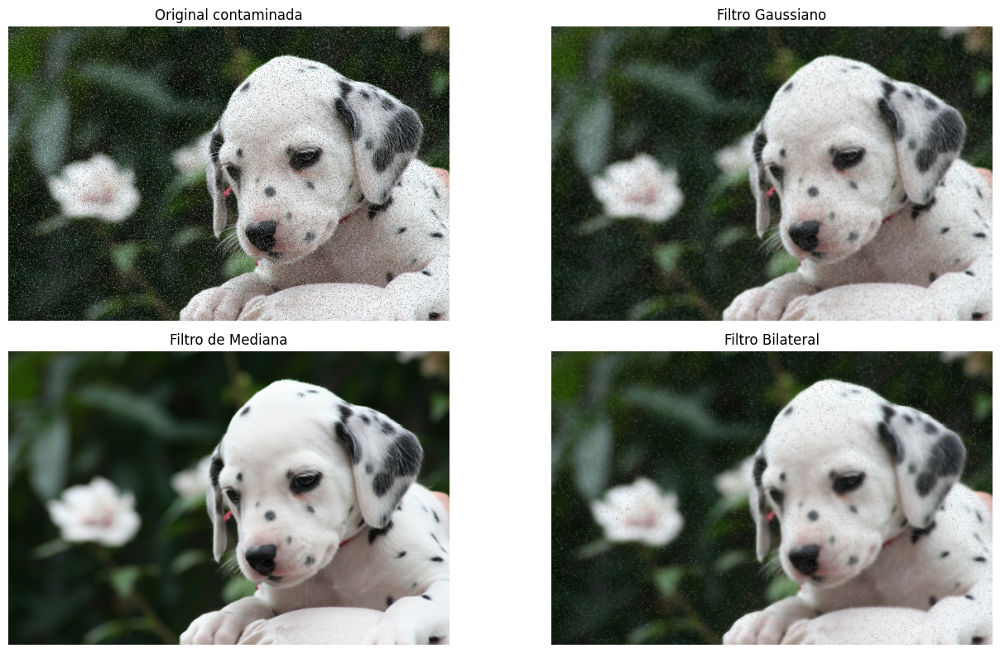

In [724]:
# Se muestran los resultados comparativos
plt.figure(figsize=(14, 8))

plt.subplot(2, 2, 1)
plt.imshow(imgdog_sp)
plt.title("Original contaminada")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(imagen_gauss)
plt.title("Filtro Gaussiano")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(imagen_mediana)
plt.title("Filtro de Mediana")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(imagen_bilateral)
plt.title("Filtro Bilateral")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En esta comparación se observa que el filtro de Gauss realiza una reducción general de ruido y produce un difuminado sin mucha preservación de los bordes. 
# El filtro de la Mediana es muy efectivo para quitar el ruido y el filtro Bilateral suaviza el ruido manteniendo bordes bien definidos, ideal para visualización
# estética y bordes limpios.  

### 6) Implementar el filtro de difusión anisotrópica y aplicarlo a imágenes y sus versiones contaminadas. Analizar los resultados y comparar con el filtro de Gauss y con el filtro de la mediana.

El filtro de difusión anisotrópica, también conocido como difusión de Perona-Malik, es un método iterativo que reduce el ruido, como lo haría una difusión térmica (desenfoque progresivo), pero preserva los bordes regulando la difusión según el gradiente de intensidad local. Es una ecuación diferencial parcial (EDP) que simula una “difusión dirigida”, controlada por una función de conductancia.

In [ ]:
# Se definen las funciones que permiten aplicar el filtro de difusión anisotrópica:

def difusion_anisotropica(imagen_rgb, n_iter=15, kappa=30, gamma=0.2, funcion='exp'):
    """
    Aplica filtro de difusión anisotrópica (Perona-Malik) a una imagen RGB.

    Args:
        imagen_rgb: Imagen en formato RGB (uint8).
        n_iter: Número de iteraciones.
        kappa: Sensibilidad al gradiente (umbral de conductancia).
        gamma: Paso de integración (0 < gamma <= 0.25 para estabilidad).
        funcion: 'exp' (exponencial) o 'inv' (inversa).

    Returns:
        Imagen filtrada (uint8).
    """
    # Se establece la funcion de conductancia
    def conductancia(gradiente, kappa, tipo='exp'):
        if tipo == 'exp':
            return np.exp(-(gradiente / kappa)**2)
        elif tipo == 'inv':
            return 1. / (1. + (gradiente / kappa)**2)
        else:
            raise ValueError("Tipo de función de conductancia no válida.")

    imagen = imagen_rgb.astype(np.float32)
    canales = cv2.split(imagen)
    canales_filtrados = []

    for c in canales:
        I = c.copy()
        for _ in range(n_iter):
            # Diferencias con vecinos
            norte = np.roll(I, -1, axis=0) - I
            sur   = np.roll(I,  1, axis=0) - I
            este  = np.roll(I,  1, axis=1) - I
            oeste = np.roll(I, -1, axis=1) - I

            # Se calculan los gradientes
            cN = conductancia(norte, kappa, funcion)
            cS = conductancia(sur,   kappa, funcion)
            cE = conductancia(este,  kappa, funcion)
            cO = conductancia(oeste, kappa, funcion)

            # Se actualizan de valores de los pixeles
            I += gamma * (cN * norte + cS * sur + cE * este + cO * oeste)

        canales_filtrados.append(I)
    
    # Se une los canales y reescala el rango de valores al intervalo [0, 255]
    flat = cv2.merge(canales_filtrados)
    flat = 255 * (flat - flat.min()) / (flat.max() - flat.min())

    return flat.reshape(imagen.shape).astype(np.uint8)

In [741]:
# Se aplica el filtro de difusión anisotrópica

# Primero con la imagen satelital:
imgsat_dif_rgb = difusion_anisotropica(imgsat_rgb, n_iter=20, kappa=30, gamma=0.2, funcion='exp')
imgsat_dif_sp = difusion_anisotropica(imgsat_sp, n_iter=30, kappa=80, gamma=0.1, funcion='exp')

In [731]:
# Luego con la imagen jpg:
imgdog_dif_rgb = difusion_anisotropica(imgdog_rgb, n_iter=20, kappa=30, gamma=0.2, funcion='exp')
imgdog_dif_sp = difusion_anisotropica(imgdog_sp, n_iter=30, kappa=500, gamma=0.1, funcion='exp')

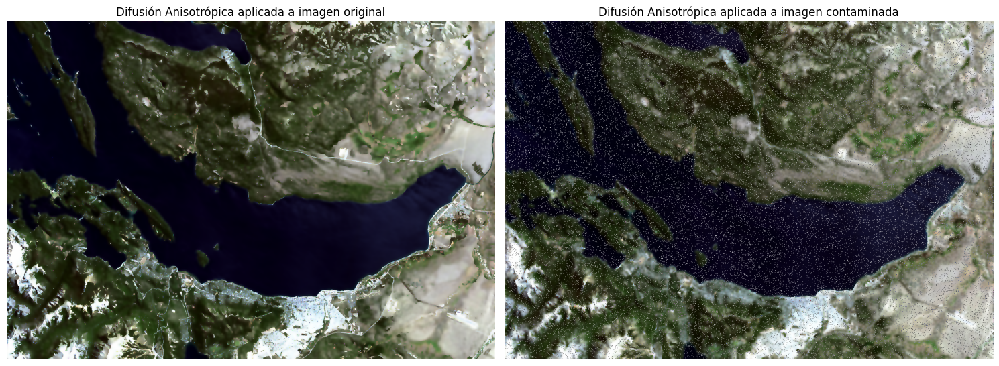

In [742]:
# Se muestran los resultados sobre la imagen satelital
plt.figure(figsize=(15, 8))
plt.subplot(1, 2, 1)
plt.imshow(imgsat_dif_rgb)
plt.title("Difusión Anisotrópica aplicada a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgsat_dif_sp)
plt.title("Difusión Anisotrópica aplicada a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

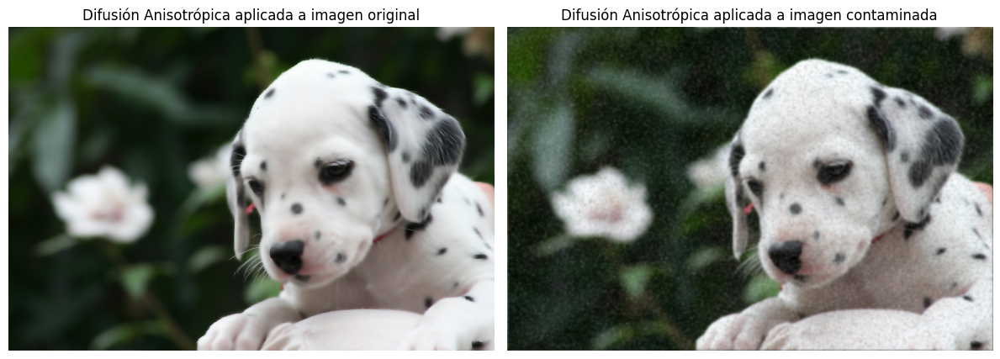

In [734]:
# Se muestran los resultados sobre la imagen jpg
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.imshow(imgdog_dif_rgb)
plt.title("Difusión Anisotrópica aplicada a imagen original")
plt.axis("off")

plt.subplot(1, 2, 2)
plt.imshow(imgdog_dif_sp)
plt.title("Difusión Anisotrópica aplicada a imagen contaminada")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En los resultados se observa que el filtro de difusión anisotrópica suaviza regiones homogéneas y converva muy bien los bordes. 

In [743]:
# Se comparan los filtros de Gauss, de la Mediana y de difusión anisotrópica:

# --- Filtro Gaussiano ---
def filtro_gaussiano(imagen_rgb, ksize=9, sigma=2):
    return cv2.GaussianBlur(imagen_rgb, (ksize, ksize), sigma)

# --- Filtro de Mediana ---
def filtro_mediana(imagen_rgb, ksize=5):
    return cv2.medianBlur(imagen_rgb, ksize)

# --- Filtro de Difusión Anisotrópica (Perona-Malik) ---
def difusion_anisotropica(imagen_rgb, n_iter=15, kappa=30, gamma=0.2, funcion='exp'):
    def conductancia(gradiente, kappa, tipo='exp'):
        if tipo == 'exp':
            return np.exp(-(gradiente / kappa)**2)
        elif tipo == 'inv':
            return 1. / (1. + (gradiente / kappa)**2)
        else:
            raise ValueError("Tipo de función de conductancia no válida.")

    imagen = imagen_rgb.astype(np.float32)
    canales = cv2.split(imagen)
    canales_filtrados = []

    for c in canales:
        I = c.copy()
        for _ in range(n_iter):
            norte = np.roll(I, -1, axis=0) - I
            sur   = np.roll(I,  1, axis=0) - I
            este  = np.roll(I,  1, axis=1) - I
            oeste = np.roll(I, -1, axis=1) - I

            cN = conductancia(norte, kappa, funcion)
            cS = conductancia(sur,   kappa, funcion)
            cE = conductancia(este,  kappa, funcion)
            cO = conductancia(oeste, kappa, funcion)

            I += gamma * (cN * norte + cS * sur + cE * este + cO * oeste)

        canales_filtrados.append(I)

    flat = cv2.merge(canales_filtrados)
    flat = 255 * (flat - flat.min()) / (flat.max() - flat.min())

    return flat.reshape(imagen.shape).astype(np.uint8)
    

In [746]:
# Se aplican los filtros

gauss = filtro_gaussiano(imgdog_sp, ksize=9, sigma=2)
mediana = filtro_mediana(imgdog_sp, ksize=5)
anisotropica = difusion_anisotropica(imgdog_sp, n_iter=20, kappa=200, gamma=0.2, funcion='exp')

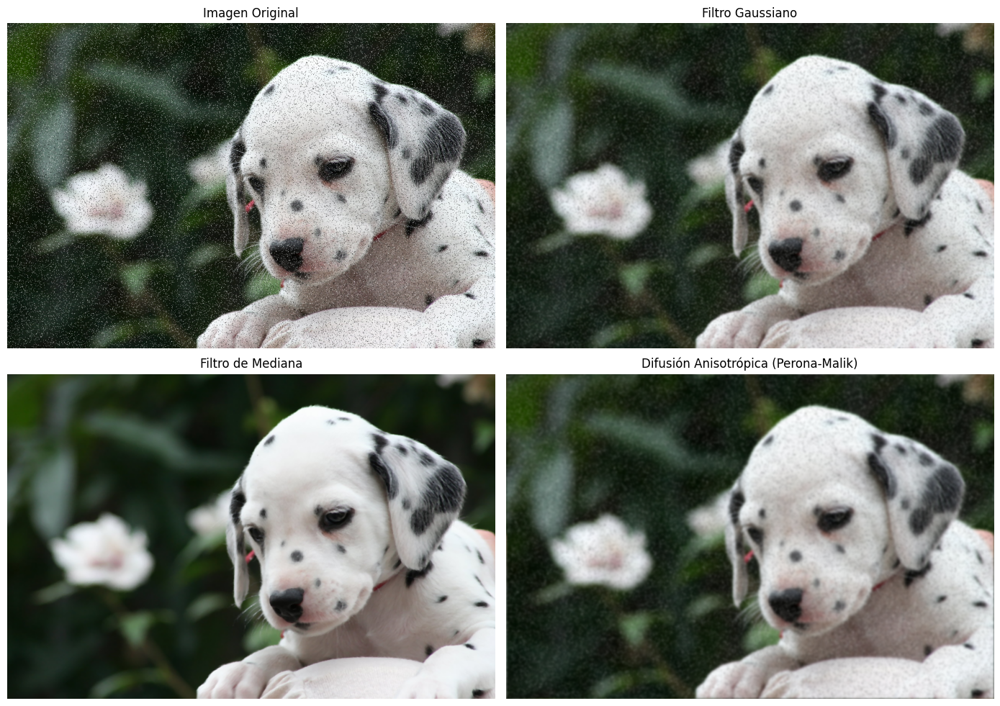

In [747]:
# Se muestran las comparaciones
plt.figure(figsize=(14, 10))

plt.subplot(2, 2, 1)
plt.imshow(imgdog_sp)
plt.title("Imagen Original")
plt.axis("off")

plt.subplot(2, 2, 2)
plt.imshow(gauss)
plt.title("Filtro Gaussiano")
plt.axis("off")

plt.subplot(2, 2, 3)
plt.imshow(mediana)
plt.title("Filtro de Mediana")
plt.axis("off")

plt.subplot(2, 2, 4)
plt.imshow(anisotropica)
plt.title("Difusión Anisotrópica (Perona-Malik)")
plt.axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# En las imágenes de comparación se observa que el filtro Gaussiano suaviza el ruido, pero difumina bordes, mientras que el filtro de la Mediana elimina el ruido de tipo impulsivo, 
# y el filtro de difusión anisotrópica permite suavizar sin borrar bordes fuertes.

### 7) Respuestas a preguntas teóricas.

a) ¿Cómo se construye el filtro Gaussiano? ¿De qué parámetros depende?

El filtro Gaussiano es un filtro lineal basado en la función Gaussiana 2D, que aplica un suavizado ponderado: los píxeles más cercanos al centro tienen más peso que los lejanos.

$$
G(x, y) = \frac{1}{2\pi\sigma^2} \cdot e^{-\frac{x^2 + y^2}{2\sigma^2}}
$$

Donde:

$x,y$: son las coordenadas respecto del centro del kernel

$\sigma$: es la desviación estándar, controla la "anchura" del filtro.

El filtro Gaussiano se contruye a partir de los siguientes pasos:

1. Se elige un tamaño del kernel (ej. $k = 5$ -> 5x5)

2. Se calcula el centro: $c = [k/2]$.

3. Para cada posición $(i,j)$ del kernel:

$$
G(i, j) = \frac{1}{2\pi\sigma^2} \cdot \exp\left( -\frac{(i - c)^2 + (j - c)^2}{2\sigma^2} \right)
$$

4. Se normaliza el kernel dividiendo todos los valores por la suma total para que:

$$
\sum_{i,j} G(i, j) = 1
$$

Este filtro depende de los siguentes parámetros:

- Tamaño del kernel: debe ser impar
- $\sigma$ (sigma): la desviación estándar define cuánto se difumina la imagen

b) ¿Cómo se construye el operador Laplaciano del Gaussiano (LoG)?

El LoG (Laplacian of Gaussian) es un operador que primero suaviza la imagen con una función Gaussiana y luego aplica el Laplaciano, que destaca las regiones donde la intensidad cambia rápidamente (bordes).

Se define matemáticamente como:
$$
\nabla^2 G(x, y) = \frac{\partial^2 G}{\partial x^2} + \frac{\partial^2 G}{\partial y^2}
$$

Donde $G(x,y)$ es la función Gaussiana 2D:
$$
G(x, y) = \frac{1}{2\pi\sigma^2} \cdot e^{-\frac{x^2 + y^2}{2\sigma^2}}
$$

Y el operador completo LoG es:
$$
LoG(x, y) = \nabla^2 G(x, y)
$$
$$
LoG(x, y) = \left( \frac{x^2 + y^2 - 2\sigma^2}{\sigma^4} \right) \cdot \frac{1}{2\pi\sigma^2} \cdot e^{-\frac{x^2 + y^2}{2\sigma^2}}
$$

El kernel LoG se construye a partir de los siguientes pasos:

1. Se elige un tamaño de kernek $k$ (ej. 5x5, 9x9)

2. Se calcula el centro: $c = [k/2]$.

3. Para cada coordenada $(i,j)$, se evalúa el LoG en:
$$
x = i - c, y = j - c
$$

4. Se calcula el valor:
$$
LoG(i, j) = \left( \frac{(x^2 + y^2 - 2\sigma^2)}{\sigma^4} \right) \cdot e^{-\frac{x^2 + y^2}{2\sigma^2}}
$$

5. El kernel puede o no normalizarse, según la aplicación (suele tener suma cero).

c) Explique la razón por la cual el método de Perona-Malik posee un comportamiento distinto fuera de los bordes y a través de ellos.

La ecuación general de Perona-Malik para una imagen $I(x,y,t)$ es:
$$
\frac{\partial I}{\partial t} = \nabla \cdot \left( c(|\nabla I|) \nabla I \right)
$$
o bien,
$$
\frac{\partial I}{\partial t} = c(|\nabla I|) \Delta I + \nabla c \cdot \nabla I
$$
Donde:
- $|\nabla I|$ es el módulo del gradiente (magnitud del cambio de intensidad),
- $c(|\nabla I|)$ es una función de conductancia que decrece cuando el gradiente es grande.

En áreas donde la imagen presenta intensidad relativamente uniforme, el gradiente local $|\nabla I|$ es pequeño o cercano a cero. Estas regiones corresponden típicamente a:
- Fondos uniformes
- Áreas internas de objetos
- Zonas con variaciones suaves de intensidad.

Cuando $|\nabla I| \thickapprox 0$, la función $g(|\nabla I|)$ toma valores cercanos a 1 debido a su naturaleza monótona decreciente. Esto resulta en: 
- Coeficiente de difusión alto: $c \thickapprox 1$
- Difusión intensa: El suavizado es máximo en estas regiones
- Eliminación efectiva de ruido: Las variaciones aleatorias se promedian entre píxeles vecinos.

El algoritmo permite que "la difusión se produzca principalmente en el interior de las regiones", creando un efecto que homogeniza la textura mientras preserva la información estructural importante.

Los bordes se caracterizan por cambios abruptos en la intensidad de la imagen, resultando en gradientes de magnitud grande. Estas transiciones corresponden a:
- Contornos de objetos
- Límites entre regiones de diferente intensidad
- Estructuras lineales importantes.

Cuando $|\nabla I|$ es grande, la función $g(|\nabla I|)$ tiende hacia cero. Este comportamiento produce:
- Coeficiente de difusión bajo: $c \thickapprox 0$
- Difusión mínima o nula: El suavizado se detiene o reduce significativamente
- Preservación de la estructura: Los bordes mantienen su nitidez y localización.
